# Imports

In [165]:
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

# Image show 

In [166]:
def show_images(input_image, output_image, title):
  images = np.concatenate((input_image, output_image), axis=1)
  print('\n\n')
  print('----------------------------------------------------------------------------' + '       '+ title +'        ' + '-----------------------------------------------------------------')
  print('\n\n')
  cv2_imshow(images)
  cv2.waitKey(0)
  cv2.destroyAllWindows()

# Custom 2D Filter

In [167]:
def custom2dFilter(image, kernel):
    m, n = kernel.shape
    pad = (m-1)//2
    image = np.pad(image, pad_width=pad)
    y, x = image.shape
    y_out = y - m + 1
    x_out  = x - n + 1
    new_image = np.zeros((y_out, x_out))
    for i in range(y_out):
        for j in range(x_out):
            new_image[i][j] = np.sum(image[i:i+m, j:j+n]*kernel)
    return new_image

# Kirsch mask

In [168]:
KIRSCH_K1 = np.array([[ 5, -3, -3], [ 5,  0, -3], [ 5, -3, -3]], dtype=np.float32) / 15
KIRSCH_K2 = np.array([[-3, -3,  5], [-3,  0,  5], [-3, -3,  5]], dtype=np.float32) / 15
KIRSCH_K3 = np.array([[-3, -3, -3], [ 5,  0, -3], [ 5,  5, -3]], dtype=np.float32) / 15
KIRSCH_K4 = np.array([[-3,  5,  5], [-3,  0,  5], [-3, -3, -3]], dtype=np.float32) / 15
KIRSCH_K5 = np.array([[-3, -3, -3], [-3,  0, -3], [ 5,  5,  5]], dtype=np.float32) / 15
KIRSCH_K6 = np.array([[ 5,  5,  5], [-3,  0, -3], [-3, -3, -3]], dtype=np.float32) / 15
KIRSCH_K7 = np.array([[-3, -3, -3], [-3,  0,  5], [-3,  5,  5]], dtype=np.float32) / 15
KIRSCH_K8 = np.array([[ 5,  5, -3], [ 5,  0, -3], [-3, -3, -3]], dtype=np.float32) / 15

def kirsch_filter(img) :
    fimg = np.maximum(custom2dFilter(img, KIRSCH_K1),
           np.maximum(custom2dFilter(img, KIRSCH_K2),
           np.maximum(custom2dFilter(img, KIRSCH_K3),
           np.maximum(custom2dFilter(img, KIRSCH_K4),
           np.maximum(custom2dFilter(img, KIRSCH_K5),
           np.maximum(custom2dFilter(img, KIRSCH_K6),
           np.maximum(custom2dFilter(img, KIRSCH_K7),
           custom2dFilter(img, KIRSCH_K8))))))))
    return(fimg)

# Laplacian operator

In [169]:
LAPLACIAN_K1 = np.array([[ 0, 1, 0], [ 1,  -4, 1], [ 0, 1, 0]], dtype=np.float32)
LAPLACIAN_K2 = np.array([[0, -1,  0], [-1,  4,  -1], [0, -1,  0]], dtype=np.float32)

def laplacian_filter(img) :
    fimg = np.maximum(custom2dFilter(img, LAPLACIAN_K1),
           custom2dFilter(img, LAPLACIAN_K2))
    return(fimg)

# Filters apply function

In [170]:
def apply_filters():
    for image_info in images:
      show_images(image_info['image'], kirsch_filter(image_info['image']), image_info['title'] + ' Kirsch Mask')
      show_images(image_info['image'], laplacian_filter(image_info['image']), image_info['title'] + ' Laplacian Operator')

# Image initialization

In [171]:
high_detalization_image = cv2.imread('./images/high_detalization.png', 0)
hight_contrast_image = cv2.imread('./images/hight_contrast.png', 0)
low_contrast_image = cv2.imread('./images/low_contrast.png', 0)
low_detalization_image = cv2.imread('./images/low_detalization.png', 0)

images = [
          {'image': high_detalization_image, 'title': 'Hight detalization'},
          {'image': low_detalization_image, 'title': 'Low detalization'},
          {'image': hight_contrast_image, 'title': 'Hight contrast'},
          {'image': low_contrast_image, 'title': 'Low contrast'}, 
]

# Results




----------------------------------------------------------------------------       Hight detalization Kirsch Mask        -----------------------------------------------------------------





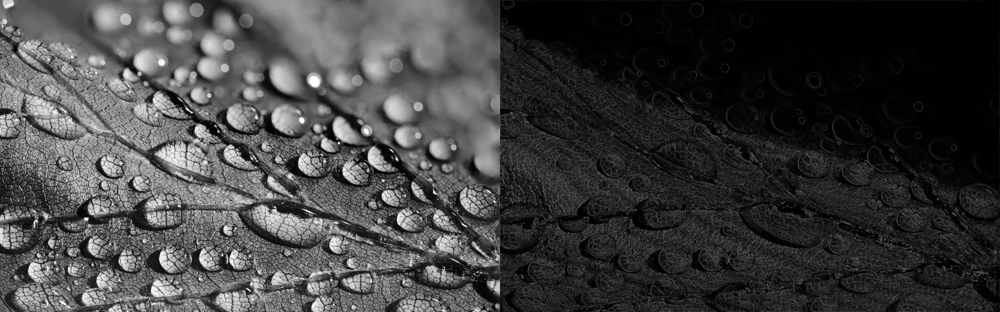




----------------------------------------------------------------------------       Hight detalization Laplacian Operator        -----------------------------------------------------------------





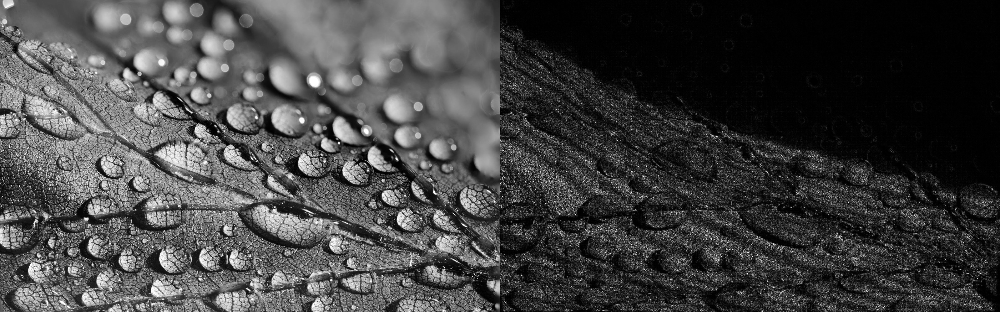




----------------------------------------------------------------------------       Low detalization Kirsch Mask        -----------------------------------------------------------------





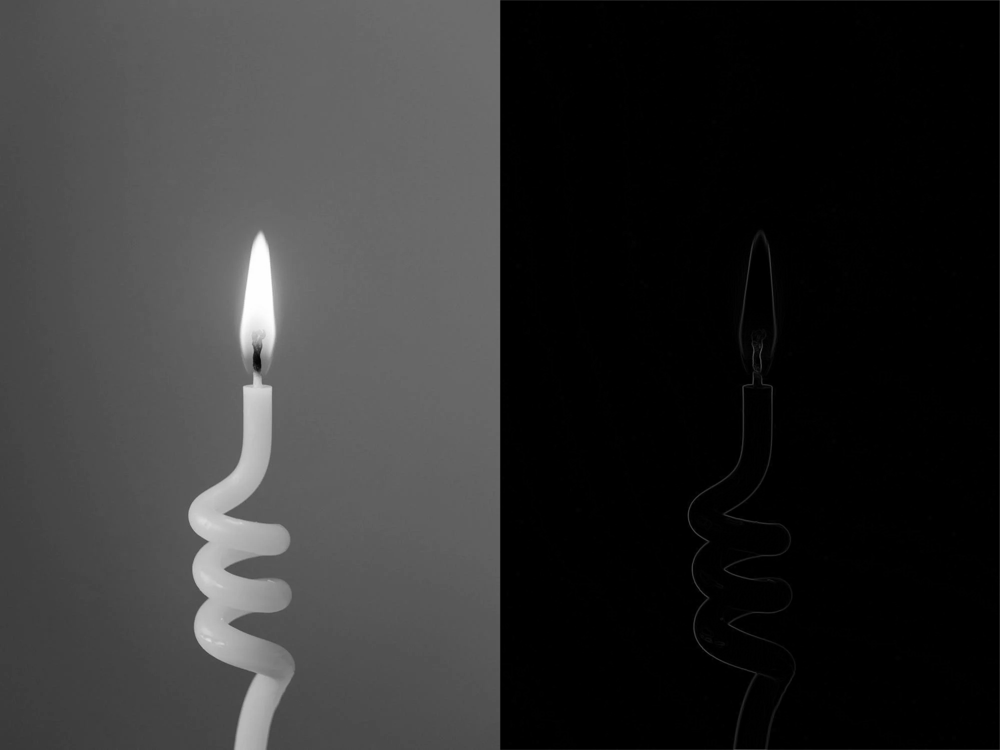




----------------------------------------------------------------------------       Low detalization Laplacian Operator        -----------------------------------------------------------------





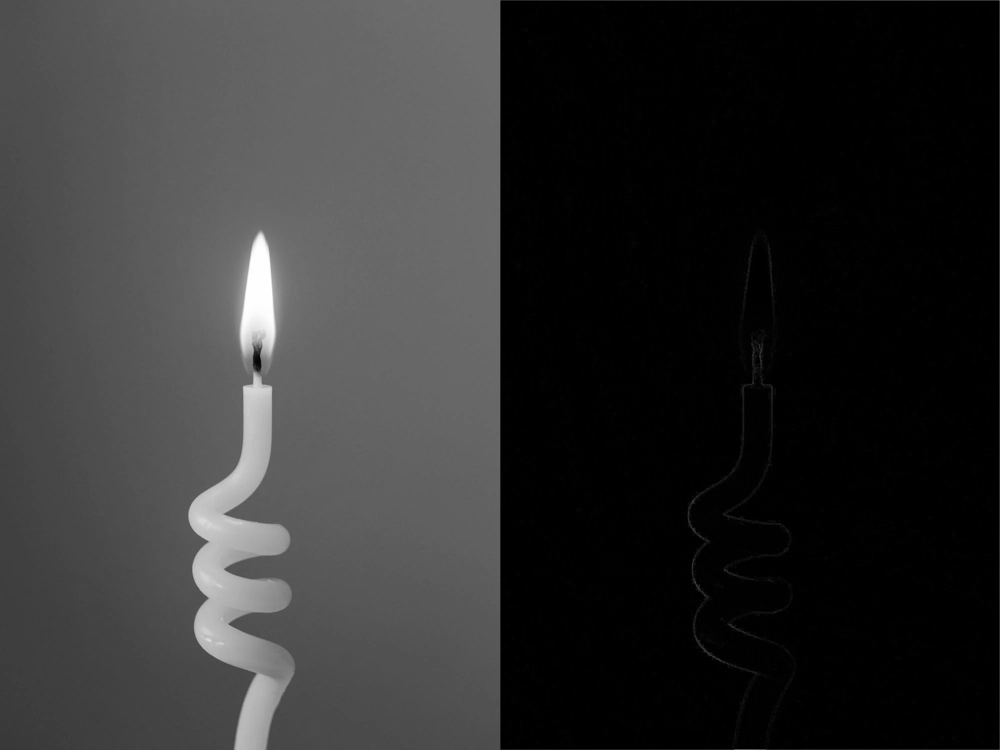




----------------------------------------------------------------------------       Hight contrast Kirsch Mask        -----------------------------------------------------------------





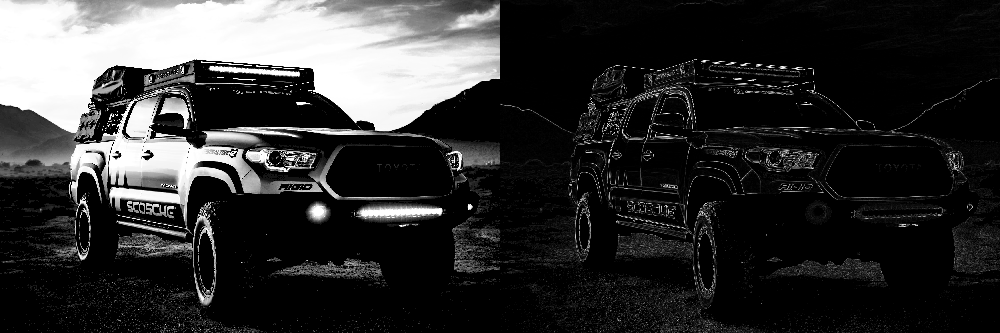




----------------------------------------------------------------------------       Hight contrast Laplacian Operator        -----------------------------------------------------------------





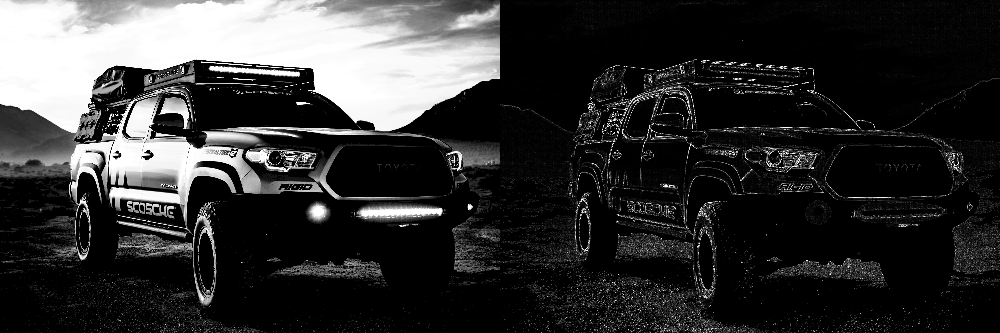




----------------------------------------------------------------------------       Low contrast Kirsch Mask        -----------------------------------------------------------------





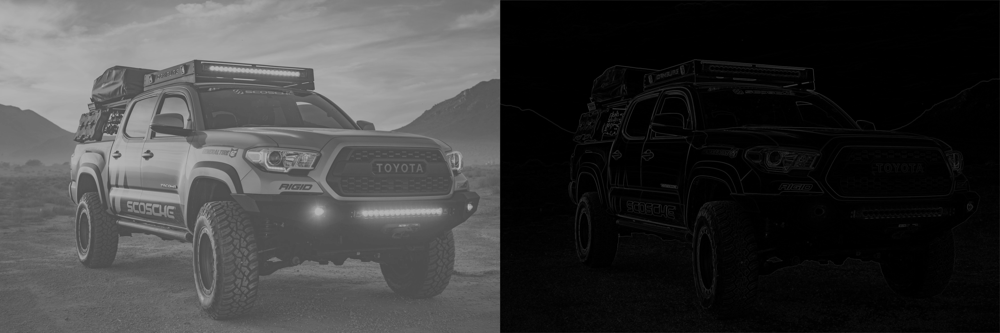




----------------------------------------------------------------------------       Low contrast Laplacian Operator        -----------------------------------------------------------------





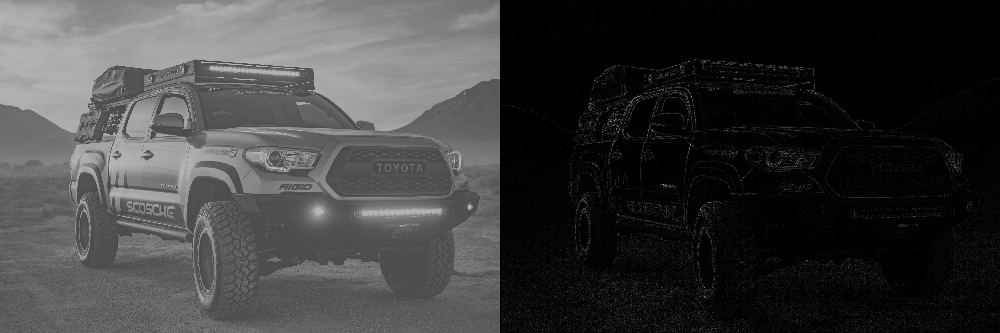

In [172]:
apply_filters()